# Introduction

Over the years, we have seen how decision making and analytics in many industries are increasingly being driven by data and models. Many organizations are starting to embrace the use of machine learning as part of business optimization. However, machine learning models are only as good as the quality of data used to train them. We could consider how financial institutions use client information such as transaction amounts or locations to detect credit card fraud, having unclean data on these observations can easily throw off a machine learning model. So once data is collected from various sources, the first thing is to ensure that the data is cleaned appropriately before being feed into a model.

Data preprocessing is never an easy step and many data scientists face several challenges when it comes to data preprocessing. Aside from the challenge of understanding the business problem and trying to come up with the best approach to solving it, data preprocessing is also an area that requires a lot of time and input. In this article, I used the scientific Python ecosystem and geospatial data visualization & analysis capabilities of Folium and the ArcGIS platform to highlight some of the key approaches to data preprocessing, namely; Data cleaning, Exploratory data analysis, variable transformation and feature engineering.

I used the Chicago housing data obtained from [Github](https://github.com/ageron/handson-ml2/tree/master/datasets/housing). The data set contains 20640 entries. Each entry represents one district. There are 10 attributes longitude, latitude, housing_median_age, total_rooms, total_bed rooms, population, households, median_income, median_house_value, and ocean_proximity. This dataset was based on data from the 1990 California census. It is not exactly recent, but it has many qualities for learning, so we will pretend it is recent data.

### Data Collection

In a typical real world setting, data is usual spread across multiple tables/documents/files from different sources. To access this data, you would first need to get your credentials and access authorizations. however, for the dataset i used, things were alot simpler, I simply just downloaded a single compressed file which contained a csv file with all the data.

To download this file, I created small a function. Once the function is called, it creates a dataset/housing, downloads the housing.tgz, and extracts the housing.csv from the directory. This approach is particularly useful if data changes are made to the original file, it makes it possible to fetch these changes whenever the code is run. 

#### Retriveing Data

In [1]:
# Import the necessary libraries
import os
import tarfile
from six.moves import urllib
import warnings
warnings.filterwarnings('ignore')

In [2]:
DOWNLOAD_ROOT = "https://raw.githubusercontent.com/ageron/handson-ml2/master/"
HOUSING_PATH = os.path.join("datasets", "housing")
HOUSING_URL = DOWNLOAD_ROOT + "datasets/housing/housing.tgz"

In [3]:
# Function to fetch the data
def fetch_housing_data(housing_url=HOUSING_URL, housing_path=HOUSING_PATH):
    if not os.path.isdir(housing_path):
        os.makedirs(housing_path)
    tgz_path = os.path.join(housing_path, "housing.tgz")
    urllib.request.urlretrieve(housing_url, tgz_path)
    housing_tgz = tarfile.open(tgz_path)
    housing_tgz.extractall(path=housing_path)
    housing_tgz.close()

In [4]:
# Call function to fetch the data
fetch_housing_data()

In [5]:
# library to handle data in a vectorized manner
import numpy as np 

# library for data analsysis
import pandas as pd 
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [6]:
def load_housing_data(housing_path=HOUSING_PATH):
    csv_path = os.path.join(housing_path, "housing.csv")
    return pd.read_csv(csv_path)

Take a quick look at the Data Structure

In [7]:
housing = load_housing_data()
housing.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [8]:
housing.shape

(20640, 10)

In [9]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


There are 10 attributes in total, 9 of which are numerical (*float64*) and ocean_proximity being the only non-numeric attribute with *object* type.

In [10]:
# make a copy of the orignal dataframe
housing_df = housing.copy()

### Data Cleaning 

#### Missing data

In [11]:
#check for missing data
missing_data = housing_df.isnull()
missing_data.head(5)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False


In [12]:
for column in missing_data.columns.values.tolist():
    print(column)
    print (missing_data[column].value_counts())
    print("")  

longitude
False    20640
Name: longitude, dtype: int64

latitude
False    20640
Name: latitude, dtype: int64

housing_median_age
False    20640
Name: housing_median_age, dtype: int64

total_rooms
False    20640
Name: total_rooms, dtype: int64

total_bedrooms
False    20433
True       207
Name: total_bedrooms, dtype: int64

population
False    20640
Name: population, dtype: int64

households
False    20640
Name: households, dtype: int64

median_income
False    20640
Name: median_income, dtype: int64

median_house_value
False    20640
Name: median_house_value, dtype: int64

ocean_proximity
False    20640
Name: ocean_proximity, dtype: int64



In [13]:
# missing data for variables
total_missing_values = housing_df.isnull().sum().sort_values(ascending=False)
percentage = (housing_df.isnull().sum()/housing.isnull().count()).sort_values(ascending=False)
missing_data_df = pd.concat([total_missing_values, percentage], axis=1, keys=['total missing values', 'percentage'])
missing_data_df.head()

,total missing values,percentage
total_bedrooms,207,0.010029
ocean_proximity,0,0.000000
median_house_value,0,0.000000
median_income,0,0.000000
households,0,0.000000


Based on the summary, there is one column containing missing data:

<ol>
    <li>'total_bedrooms': 207 missing values (1.0029%)</li>
</ol>    

207 entries in the *total_bedrooms* column were recorded as NA representative of a lack of a decribed attribute. Thus, these types of missing values were handled as follows: 

<b>Replace by mean:</b>

<ul>
    <li>'total_bedrooms': 207 missing values, replace them with mean.</li>
</ul>

In [14]:
avg_total_bedrooms = housing_df['total_bedrooms'].astype('float').mean(axis=0)
print('Average of total-bedrooms:', avg_total_bedrooms)

Average of total-bedrooms: 537.8705525375618


In [15]:
housing_df['total_bedrooms'].replace(np.nan, avg_total_bedrooms, inplace=True)

Rarely does a data scientist avoid the problem of missing data. Once the missing data is identified, the challenge is to address the issues raised by missing data. To do so, the data scientist's primary concern is to look for patterns and relationships underlying the missing data to maintain as close as possible the original distribution of values when any remedy is applied. Based on [Hair et al. (2013)](https://books.google.co.zm/books?id=JlRaAAAAYAAJ), chapter 'Examining your data', Missing data under 10% for an individual case or observation can generally be ignored. Once this decision is made, the data scientist must apply specialized techniques for ignorable missing data. Pandas makes it extremely easy to sanitize tabular data. 

In [16]:
# check for missing data after remedy
housing_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20640 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


#### Outliers

In [17]:
# filter out all numeric variables
numeric_vars = housing_df[['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms',
                          'population', 'households', 'median_income', 'median_house_value']]

Outliers in real estate data could be due to several reasons. Typographical errors during data entry could lead to outliers. Plotting the distribution of numeric columns can give a sense of outliers in the data set. I used two different kinds of plots to check for the presence of outliers. A histogram plot and box plot.

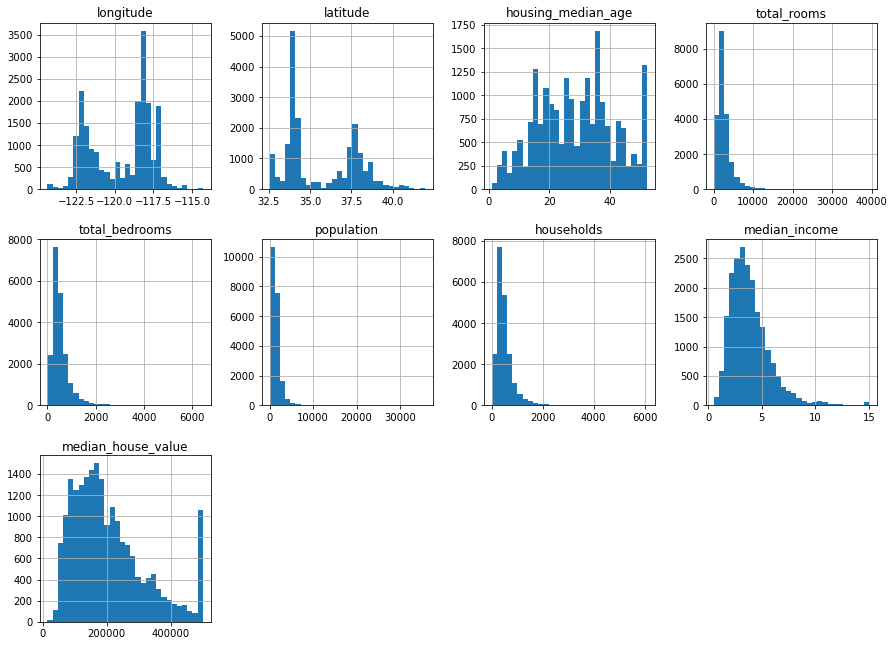

In [18]:
# explore distribution of numeric columns
ax_list = numeric_vars.hist(bins=30, layout=(4,4), figsize=(15,15))

In [19]:
# descriptive statistics
numeric_vars.describe()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,419.266592,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,297.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,438.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,643.250000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


In [20]:
# import library for plots
import matplotlib.pyplot as plt

%matplotlib inline  

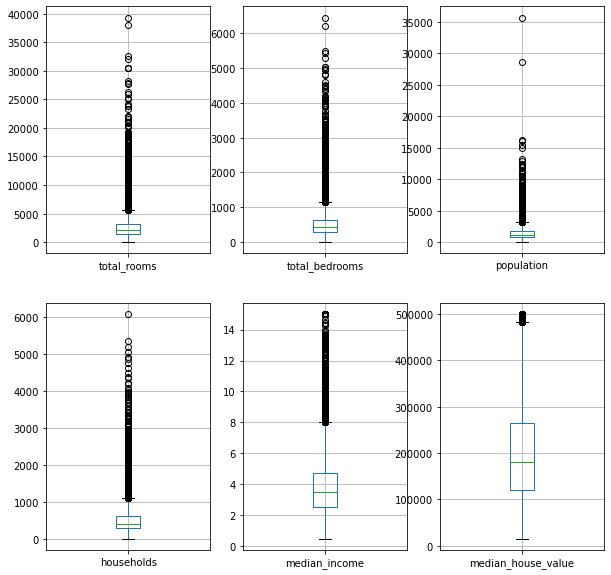

In [21]:
# create boxplots
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(10,10)) # create 2x3 array of subplots

housing_df.boxplot(column='total_rooms', ax=axes[0,0]) # add boxplot to 1st subplot
housing_df.boxplot(column='total_bedrooms', ax=axes[0,1])# add boxplot to 2nd subplot
housing_df.boxplot(column='population', ax=axes[0,2])
housing_df.boxplot(column='households', ax=axes[1,0])
housing_df.boxplot(column='median_income', ax=axes[1,1])
housing_df.boxplot(column='median_house_value', ax=axes[1,2])

plt.show()

From the boxplots above, it appears that there are several outliers to be concerned about.  *Total_rooms*, *total_bedrooms*, *population*, *households*, *median_income* appear to have the most number of outliers, whereas *median_house_value* does not seem to have that many outliers, but we can not know for sure. From the histogram, we see a huge presence of skewing in the distribution which could also be a result of outliers. A few different approaches exist to filter outliers. A popular technique is to use a 6 sigma filter which removes values that are greater than 3 standard deviations from the mean. This filter assumes that the data follows a normal distribution and uses the mean as the measure of centrality. However, when data suffers heavily from outliers, as in this case, the mean can get distorted. An Inter Quartile Range (IQR) filter which uses median, a more robust measure of centrality, can filter out outliers that are at a set distance from the median in a more reliable fashion.

In [22]:
#six_sigma
def six_sigma_filter(df, column):
    sigma = df[column].std()
    mu = df[column].mean()
    three_sigma = [mu-(3*sigma), mu+(3*sigma)]
    print("Column:{}, Mean:{}, Sigma:{}, 3sigma_range: {}:{}".format(column,mu,
                                                                       sigma,
                                                                       three_sigma[0],
                                                                       three_sigma[1]))
    
    # filter
    df_to_keep = df[(df[column] > three_sigma[0]) & (df[column] < three_sigma[1])]
    
    # prints
    num_rows_dropped = housing_df.shape[0] - df_to_keep.shape[0]
    print("Number of rows dropped: " + str(num_rows_dropped))
    
    return df_to_keep

In [23]:
#Interquatile range filter
def iqr_filter(df, column):
    med = df[column].median()
    p_25 = df[column].quantile(q=0.25)
    p_75 = df[column].quantile(q=0.75)
    
    # find valid range
    iqr_range = [med-(2*p_25), med+(2*p_75)]
    print("Column: {}, Median:{}, 25%:{}, 75%:{}, IQR:{}:{}".format(column,med,
                                                                    p_25,p_75,
                                                                    iqr_range[0],
                                                                    iqr_range[1]))
    
    # filter
    df_to_keep = df[(df[column] > iqr_range[0]) & (df[column] < iqr_range[1])]
    
    #prints
    num_rows_dropped = housing_df.shape[0] - df_to_keep.shape[0]
    print("Number of rows dropped: " + str(num_rows_dropped))
    
    return df_to_keep

In [24]:
housing_df1 = six_sigma_filter(housing_df, 'total_rooms')

Column:total_rooms, Mean:2635.7630813953488, Sigma:2181.615251582787, 3sigma_range: -3909.0826733530125:9180.60883614371
Number of rows dropped: 373


In [25]:
housing_df1_iqr = iqr_filter(housing_df, 'total_rooms')

Column: total_rooms, Median:2127.0, 25%:1447.75, 75%:3148.0, IQR:-768.5:8423.0
Number of rows dropped: 465


In [26]:
housing_df2 = six_sigma_filter(housing_df1, 'total_bedrooms')

Column:total_bedrooms, Mean:503.6560153584764, Sigma:315.6313975345898, 3sigma_range: -443.238177245293:1450.5502079622458
Number of rows dropped: 740


In [27]:
housing_df2_iqr = iqr_filter(housing_df1_iqr, 'total_bedrooms')

Column: total_bedrooms, Median:431.0, 25%:294.0, 75%:624.0, IQR:-157.0:1679.0
Number of rows dropped: 585


In [28]:
housing_df3 = six_sigma_filter(housing_df2, 'population')

Column:population, Mean:1292.9757788944723, Sigma:765.4356186066481, 3sigma_range: -1003.331076925472:3589.2826347144164
Number of rows dropped: 1012


In [29]:
housing_df3_iqr = iqr_filter(housing_df2_iqr, 'population')

Column: population, Median:1146.0, 25%:777.0, 75%:1664.0, IQR:-408.0:4474.0
Number of rows dropped: 689


In [30]:
housing_df4 = six_sigma_filter(housing_df3, 'households')

Column:households, Mean:440.6523334012635, Sigma:239.41814876460592, 3sigma_range: -277.60211289255426:1158.9067796950812
Number of rows dropped: 1227


In [31]:
housing_df4_iqr = iqr_filter(housing_df3_iqr, 'households')

Column: households, Median:400.0, 25%:276.0, 75%:578.0, IQR:-152.0:1556.0
Number of rows dropped: 693


In [32]:
housing_df5 = six_sigma_filter(housing_df4, 'median_income')

Column:median_income, Mean:3.8664363622315427, Sigma:1.9141951857961792, 3sigma_range: -1.8761491951569944:9.60902191962008
Number of rows dropped: 1554


In [33]:
housing_df5_iqr = iqr_filter(housing_df4_iqr, 'median_income')

Column: median_income, Median:3.5208, 25%:2.5551, 75%:4.7222, IQR:-1.5894:12.9652
Number of rows dropped: 772


In [34]:
housing_df6 = six_sigma_filter(housing_df5, 'median_house_value')

Column:median_house_value, Mean:201551.67866499003, Sigma:111029.87533885092, 3sigma_range: -131537.94735156276:534641.3046815428
Number of rows dropped: 1554


In [35]:
housing_df6_iqr = iqr_filter(housing_df5_iqr, 'median_house_value')

Column: median_house_value, Median:178400.0, 25%:118500.0, 75%:262825.0, IQR:-58600.0:704050.0
Number of rows dropped: 772


In [36]:
(housing_df6.shape, housing_df6_iqr.shape)

((19086, 10), (19868, 10))

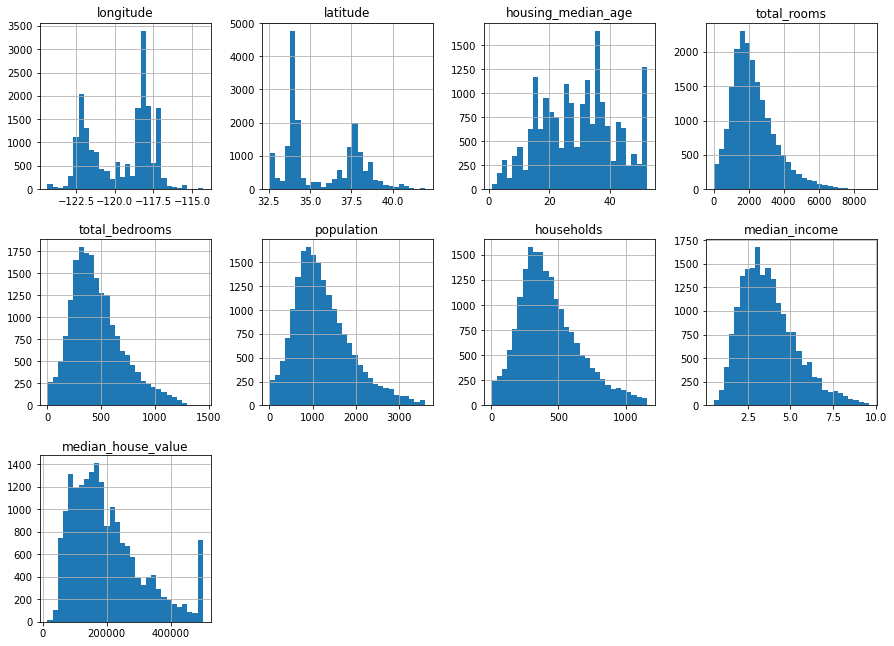

In [37]:
# explore distribution of numeric columns (6-sigma)
ax_list = housing_df6.hist(bins=30, layout=(4,4), figsize=(15,15))

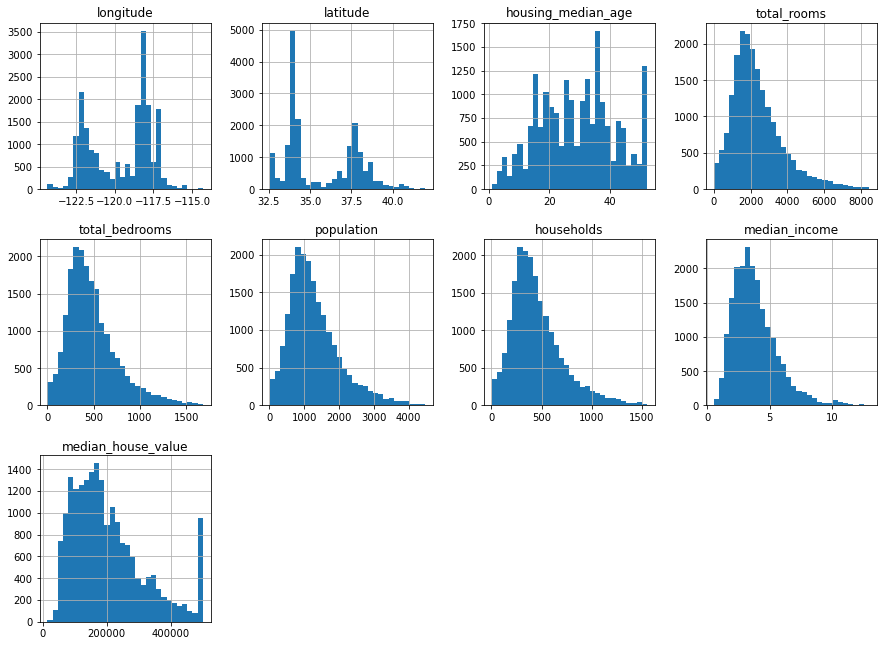

In [38]:
# explore distribution of numeric columns (IQR)
ax_list = housing_df6_iqr.hist(bins=30, layout=(4,4), figsize=(15,15))

After removing outliers using the IQR filter, the distribution of numeric columns looks much healthier.

In [39]:
# Once outliers are removed, we can use the following code to drop all the empty rows and reindex the dataframe.
# simply drop whole row with NaN in "price" column
housing_df6_iqr.dropna(subset=['latitude'], axis=0, inplace=True)

# reset index, because we droped two rows
housing_df6_iqr.reset_index(drop=True, inplace=True)

#### Data Transformation

Models used in Machine Learning Workflows often make assumptions about the data. An example is a **logistic regression model**, which assumes linearity of independent variables and log odds. An important thing to note is that linear regression forms the basis for most machine learning models and having a good understanding of the theory behind linear regression is very important.

This issue can be resolved by the use of data transformation. There are many approaches to data transformation, examples of these are log transformation, square root transformation, etc [link](http://fmwww.bc.edu/repec/bocode/t/transint.html). In this article, a square root transformation is used to transform the skewed variables.

In [40]:
# rename the dataframe
cal_new_df = housing_df6_iqr

In [41]:
# rename the dataframe
cal_housing_df = housing_df6_iqr

In [42]:
# print column names
cal_new_df.columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value', 'ocean_proximity'],
      dtype='object')

In [43]:
# Create a list of float colums to check for skewing
num_cols = ['housing_median_age', 'total_rooms','total_bedrooms', 
            'population', 'households', 'median_income','median_house_value']

skew_limit = 0.75 # define a limit above which we will log transform
skew_vals = cal_new_df[num_cols].skew()

In [44]:
# Showing the skewed columns
skew_cols = (skew_vals
             .sort_values(ascending=False)
             .to_frame()
             .rename(columns={0:'Skew'})
             .query('abs(Skew) > {}'.format(skew_limit)))

skew_cols

,Skew
median_income,1.240016
total_rooms,1.234174
total_bedrooms,1.179552
households,1.134085
population,1.115713
median_house_value,0.982136


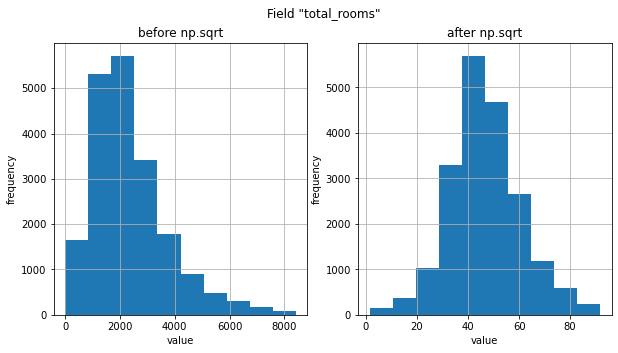

In [45]:
# Let's look at what happens to one of these features, when we apply np.log1p visually.

# Choose a field
field = "total_rooms"

# Create two "subplots" and a "figure" using matplotlib
fig, (ax_before, ax_after) = plt.subplots(1, 2, figsize=(10, 5))

# Create a histogram on the "ax_before" subplot
cal_new_df[field].hist(ax=ax_before)

# Apply a log transformation (numpy syntax) to this column
cal_new_df[field].apply(np.sqrt).hist(ax=ax_after)

# Formatting of titles etc. for each subplot
ax_before.set(title='before np.sqrt', ylabel='frequency', xlabel='value')
ax_after.set(title='after np.sqrt', ylabel='frequency', xlabel='value')
fig.suptitle('Field "{}"'.format(field));

After applying the square root transformation to *total_rooms* varibale, we can see that the variable appears to be more normally distributed. As can be see from the histogram on the right.

In [46]:
# Perform the skew transformation:

for col in skew_cols.index.values:
    cal_new_df[col] = cal_new_df[col].apply(np.sqrt)

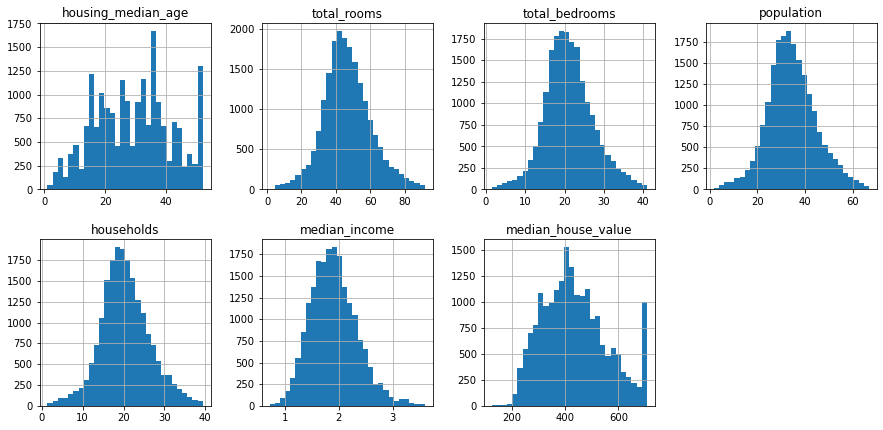

In [47]:
# explore distribution of numeric columns
ax_list = cal_new_df[num_cols].hist(bins=30, layout=(4,4), figsize=(15,15))

It appears that most of the variables are more normally distributed after the transformation.

In [48]:
idx = 0
cell = cal_housing_df.index + 1  # can be a list, a Series, an array or a scalar   
cal_housing_df.insert(loc=idx, column='id', value=cell)
#housing["id"] = housinf.index + 1

#### Exploratory Data Analysis

When it comes to exploratory data analysis, the goal is mainly to go in-depth and gain a bit more understanding of the data. At this stage of the preprocessing exercise, there are two main techniques used, statistical techniques and visual techniques.

Given that this dataset contains longitudes and latitude, one visualization approach would be to use a scatterplot to view all the districts. Since it is known that the data in the dataset is for districts in the state of California, we can see from the scatterplot below that it resembles the map of California.


<AxesSubplot:xlabel='longitude', ylabel='latitude'>

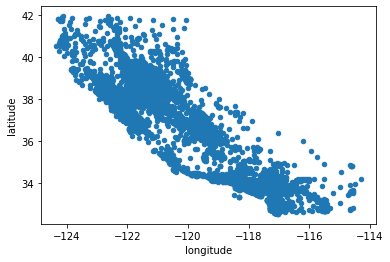

In [49]:
housing_df6_iqr.plot(kind="scatter", x="longitude", y="latitude")

Making some modifications to the diagram made it easier to visialize the places where there is a high density of data points.

<AxesSubplot:xlabel='longitude', ylabel='latitude'>

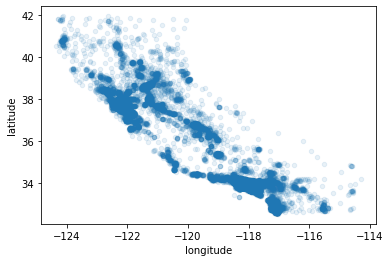

In [50]:
housing_df6_iqr.plot(kind="scatter", x="longitude", y="latitude", alpha=0.1)

You can see the high-density areas, namely the Bay Area and around Los Angeles and San Diego, plus a long line of fairly high density in the Central Valley, in particular around Sacramento and Fresno. However, this is only possible to see if one knows the exact layout of the map of California or if you are working with a map beside you.

Pandas provides an efficient API to explore the statistical distribution of the numeric columns. To explore the spatial distribution of this data set, folium for Python is used.

Similar to plotting a statistical chart out of a data frame object, a spatial plot on an interactive map widget can be plotted as shown below.


In [51]:
import folium

In [52]:
Latitude = 36.778259
Longitude = -119.417931

In [53]:
# create map and display it
cal_map = folium.Map(location=[Latitude, Longitude], zoom_start=6)


In [54]:
# instantiate a feature group for the households in the dataframe
households = folium.map.FeatureGroup()

# loop through the rows and add each to the household feature group
for lat, lng, in zip(housing_df6_iqr['latitude'], housing_df6_iqr['longitude']):
    households.add_child(
        folium.features.CircleMarker(
            [lat, lng],
            radius=3, # define how big you want the circle markers to be
            color='grey',
            fill=True,
            fill_color='blue',
            fill_opacity=0.6
        )
    )

# add households to map
cal_map.add_child(households)

Using a clustering algorithm to detect the main clusters, I was able to create a map showing the different clusters of districts, as you can see from the map below, it shows a similar kind of clustering distribution as the one noted from the scatterplot above.

In [55]:
age_bins = np.linspace(min(housing_df6_iqr["housing_median_age"]), max(housing_df6_iqr["housing_median_age"]), 6)
age_bins

array([ 1. , 11.2, 21.4, 31.6, 41.8, 52. ])

In [56]:
group_names = ['Less than 12', '12 - 22', '22 - 32', '32 - 42', '42 - 53']

In [57]:
housing_df6_iqr['median-age-bins'] = pd.cut(housing_df6_iqr["housing_median_age"], age_bins, labels=group_names, include_lowest=True )
housing_df6_iqr[['housing_median_age','median-age-bins']].head(5)

,housing_median_age,median-age-bins
0,41.0,32 - 42
1,21.0,12 - 22
2,52.0,42 - 53
3,52.0,42 - 53
4,52.0,42 - 53


In [58]:
housing_df6_iqr['median-age-bins'].value_counts()

32 - 42         5402
22 - 32         4731
12 - 22         4640
42 - 53         3539
Less than 12    1556
Name: median-age-bins, dtype: int64

Text(0.5, 1.0, 'median age bins')

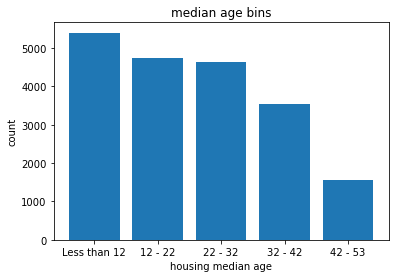

In [59]:
%matplotlib inline
import matplotlib as plt
from matplotlib import pyplot
pyplot.bar(group_names, housing_df6_iqr['median-age-bins'].value_counts())

# set x/y labels and plot title
plt.pyplot.xlabel("housing median age")
plt.pyplot.ylabel("count")
plt.pyplot.title("median age bins")

In [60]:
housing_df6_iqr.head()

,id,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,median-age-bins
0,1,-122.23,37.88,41.0,29.664794,11.357817,17.944358,11.224972,2.885342,672.755528,NEAR BAY,32 - 42
1,2,-122.22,37.86,21.0,84.255564,33.256578,49.000000,33.734256,2.881215,598.748695,NEAR BAY,12 - 22
2,3,-122.24,37.85,52.0,38.301436,13.784049,22.271057,13.304135,2.693956,593.380148,NEAR BAY,42 - 53
3,4,-122.25,37.85,52.0,35.693137,15.329710,23.622024,14.798649,2.375521,584.208867,NEAR BAY,42 - 53
4,5,-122.25,37.85,52.0,40.336088,16.733201,23.769729,16.093477,1.961173,584.978632,NEAR BAY,42 - 53


In [61]:
from folium import plugins

# let's start again with a clean copy of the map of San Francisco
cal_map3 = folium.Map(location = [Latitude, Longitude], zoom_start = 6)

# instantiate a mark cluster object for the incidents in the dataframe
incidents = plugins.MarkerCluster().add_to(cal_map3)

# loop through the dataframe and add each data point to the mark cluster
for lat, lng, label, in zip(housing_df6_iqr['latitude'], housing_df6_iqr['longitude'], housing_df6_iqr['median-age-bins']):
    folium.Marker(
        location=[lat, lng],
        icon=None,
        popup=label,
    ).add_to(incidents)

# display map
cal_map3

We could go a step further and cluster the observation based on the different counties in Chicago. To do this, we will need to create a new column to our dataset contain the different counties where these districts are found. This was done using the reverse geocode function for both Folium and ArcGIS API for Python.

In [62]:
#create df of coordinates, then convert to list
df_cal_housing = cal_housing_df[['longitude', 'latitude']]
df_cal_housing_list = df_cal_housing.values.tolist()
df_cal_housing_list_size = len(df_cal_housing_list)

In [63]:
cal_housing_df['county'] = ''

In [64]:
from arcgis.gis import GIS
from arcgis.geocoding import reverse_geocode

gis = GIS()

for point in range(0, df_cal_housing_list_size):
    try:
        results = reverse_geocode(df_cal_housing_list[point])
        
        cal_housing_df.loc[point,'county'] = results['address']['Subregion']
    except:
        cal_housing_df.loc[point,'county'] = ''
         

cal_housing_df.head()

,id,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,median-age-bins,county
0,1,-122.23,37.88,41.0,29.664794,11.357817,17.944358,11.224972,2.885342,672.755528,NEAR BAY,32 - 42,Alameda County
1,2,-122.22,37.86,21.0,84.255564,33.256578,49.000000,33.734256,2.881215,598.748695,NEAR BAY,12 - 22,Alameda County
2,3,-122.24,37.85,52.0,38.301436,13.784049,22.271057,13.304135,2.693956,593.380148,NEAR BAY,42 - 53,Alameda County
3,4,-122.25,37.85,52.0,35.693137,15.329710,23.622024,14.798649,2.375521,584.208867,NEAR BAY,42 - 53,Alameda County
4,5,-122.25,37.85,52.0,40.336088,16.733201,23.769729,16.093477,1.961173,584.978632,NEAR BAY,42 - 53,Alameda County


In [65]:
cal_housing_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19868 entries, 0 to 19867
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   id                  19868 non-null  int64   
 1   longitude           19868 non-null  float64 
 2   latitude            19868 non-null  float64 
 3   housing_median_age  19868 non-null  float64 
 4   total_rooms         19868 non-null  float64 
 5   total_bedrooms      19868 non-null  float64 
 6   population          19868 non-null  float64 
 7   households          19868 non-null  float64 
 8   median_income       19868 non-null  float64 
 9   median_house_value  19868 non-null  float64 
 10  ocean_proximity     19868 non-null  object  
 11  median-age-bins     19868 non-null  category
 12  county              19868 non-null  object  
dtypes: category(1), float64(9), int64(1), object(2)
memory usage: 1.8+ MB


In [66]:
df1 = cal_housing_df.copy()

In [67]:
new_df = df1[(df1['county'] == '')]

In [68]:
from geopy.geocoders import Nominatim

geolocator = Nominatim(user_agent = 'v2_explor')

from geopy.extra.rate_limiter import RateLimiter
geocode = RateLimiter(geolocator.reverse,min_delay_seconds = 1, return_value_on_exception = None)

for index, row in new_df.iterrows():
    try:
        location2 = geolocator.reverse((row['latitude'], row['longitude']))
        
        new_df.loc[index,'county'] = location2.raw['address']['county']
    except:
        new_df.loc[index,'county'] = ''
         

new_df.head()

,id,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,median-age-bins,county
390,391,-122.33,37.89,42.0,36.633318,17.058722,23.473389,16.309506,2.127628,455.411901,NEAR BAY,42 - 53,Alameda County
391,392,-122.34,37.88,37.0,55.326305,30.495901,50.556899,30.397368,1.318143,591.607978,NEAR BAY,32 - 42,Alameda County
530,531,-122.30,37.77,42.0,45.144213,19.183326,45.133136,18.841444,1.626253,447.213595,NEAR BAY,42 - 53,Alameda County
535,536,-122.29,37.76,18.0,53.600373,27.622455,35.256205,25.748786,2.273807,515.169875,NEAR BAY,12 - 22,Alameda County
555,556,-122.23,37.75,50.0,39.268308,17.000000,25.573424,16.370706,1.990779,489.897949,NEAR BAY,42 - 53,Alameda County


In [69]:
# reset index, because we droped two rows
new_df.reset_index(drop=True, inplace=True)

In [70]:
for point in range(0, df_cal_housing_list_size):
    try:
        df1.loc[point,'id'] == new_df.loc[point,'id']
        
        df1.loc[point,'county'] = new_df.loc[point,'county']
    except:
        pass

In [71]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19868 entries, 0 to 19867
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   id                  19868 non-null  int64   
 1   longitude           19868 non-null  float64 
 2   latitude            19868 non-null  float64 
 3   housing_median_age  19868 non-null  float64 
 4   total_rooms         19868 non-null  float64 
 5   total_bedrooms      19868 non-null  float64 
 6   population          19868 non-null  float64 
 7   households          19868 non-null  float64 
 8   median_income       19868 non-null  float64 
 9   median_house_value  19868 non-null  float64 
 10  ocean_proximity     19868 non-null  object  
 11  median-age-bins     19868 non-null  category
 12  county              19868 non-null  object  
dtypes: category(1), float64(9), int64(1), object(2)
memory usage: 1.8+ MB


In [72]:
df2 = df1.replace('', np.nan)

In [73]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19868 entries, 0 to 19867
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   id                  19868 non-null  int64   
 1   longitude           19868 non-null  float64 
 2   latitude            19868 non-null  float64 
 3   housing_median_age  19868 non-null  float64 
 4   total_rooms         19868 non-null  float64 
 5   total_bedrooms      19868 non-null  float64 
 6   population          19868 non-null  float64 
 7   households          19868 non-null  float64 
 8   median_income       19868 non-null  float64 
 9   median_house_value  19868 non-null  float64 
 10  ocean_proximity     19868 non-null  object  
 11  median-age-bins     19868 non-null  category
 12  county              19566 non-null  object  
dtypes: category(1), float64(9), int64(1), object(2)
memory usage: 1.8+ MB


In [74]:
# simply drop whole row with NaN in "price" column
df2.dropna(subset=['county'], axis=0, inplace=True)

# reset index, because we droped two rows
df2.reset_index(drop=True, inplace=True)

In [75]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19566 entries, 0 to 19565
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   id                  19566 non-null  int64   
 1   longitude           19566 non-null  float64 
 2   latitude            19566 non-null  float64 
 3   housing_median_age  19566 non-null  float64 
 4   total_rooms         19566 non-null  float64 
 5   total_bedrooms      19566 non-null  float64 
 6   population          19566 non-null  float64 
 7   households          19566 non-null  float64 
 8   median_income       19566 non-null  float64 
 9   median_house_value  19566 non-null  float64 
 10  ocean_proximity     19566 non-null  object  
 11  median-age-bins     19566 non-null  category
 12  county              19566 non-null  object  
dtypes: category(1), float64(9), int64(1), object(2)
memory usage: 1.8+ MB


In [76]:
df10 = df2[['population', 'county']]

In [77]:
df11 = df10.groupby("county")["population"].sum()

In [78]:
df12 = pd.DataFrame(df11)

In [79]:
df13 = df12.stack().reset_index()

In [80]:
df13.drop(['level_1'], axis = 1, inplace = True)

df13.rename(columns={'0':'Total_Population'}, inplace=True)

In [81]:
df13.rename(columns={0:'Total_Population'}, inplace=True)

df13

,county,Total_Population
0,Alameda County,23945.307863
1,Alpine County,56.534865
2,Amador County,799.927695
3,Butte County,4661.263014
4,Calaveras County,970.987754
5,City and County of San Francisco,4847.231298
6,Colusa County,466.151401
7,Contra Costa County,19426.014585
8,Del Norte County,562.013152
9,Douglas County,21.610183


In [82]:
california = 'C:/Users/phiri/Downloads/4a4ad6c68ab75d597610-4adc6d41320d06e42a43e4075106932ca7b44cd5/4a4ad6c68ab75d597610-4adc6d41320d06e42a43e4075106932ca7b44cd5/ca_counties.geojson'

Based on the map generated, we see that Los Angeles county has the highest population.

In [83]:
# create map and display it
california_map = folium.Map(location=[Latitude, Longitude], zoom_start=6)

folium.Choropleth(
    geo_data=california,
    name="choropleth",
    data=df13,
    columns=["county", "Total_Population"],
    key_on="feature.properties.NAMELSAD",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=.1,
    legend_name="California households",
).add_to(california_map)

folium.LayerControl().add_to(california_map)

california_map

### Continious Variables

**Looking for correlations**

In [84]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [85]:
cal_new_df.columns

Index(['id', 'longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value', 'ocean_proximity', 'median-age-bins', 'county'],
      dtype='object')

In [86]:
quant_vars = cal_new_df[['housing_median_age', 'total_rooms','total_bedrooms', 'population', 
                             'households', 'median_income','median_house_value']]

In [87]:
quant_vars.corr()

,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
housing_median_age,1.000000,-0.320105,-0.260092,-0.236122,-0.233834,-0.135280,0.098175
total_rooms,-0.320105,1.000000,0.909851,0.819206,0.905130,0.269177,0.195397
total_bedrooms,-0.260092,0.909851,1.000000,0.860078,0.967201,-0.017445,0.077821
population,-0.236122,0.819206,0.860078,1.000000,0.902810,-0.003258,-0.015720
households,-0.233834,0.905130,0.967201,0.902810,1.000000,0.019285,0.102826
median_income,-0.135280,0.269177,-0.017445,-0.003258,0.019285,1.000000,0.684599
median_house_value,0.098175,0.195397,0.077821,-0.015720,0.102826,0.684599,1.000000


Correlation coefficient range from -1 to 1. A correlation coefficient close to 1, is representative of a strong positive linear relationship; for example when a correlation coefficient of 0.68 between *median_income* and *median_house_value*. This means that as the *median_income* increase so does the *mean_house_value*. A correlation coeficient of -1 means there is a strong negative relationship. Finally, coefficient close to zero means that there is no linear correlation.

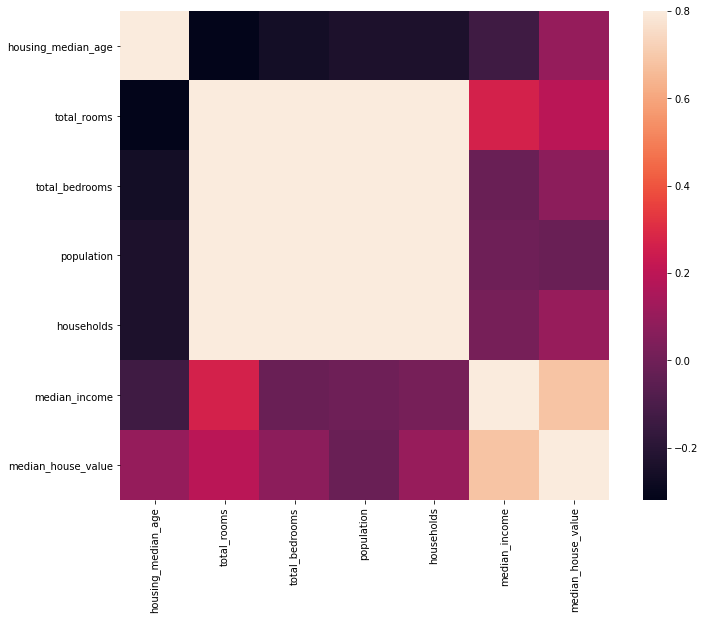

In [88]:
quant_corr = quant_vars.corr()
f, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(quant_corr, vmax=.8, square=True);

We can also check the correlation between attributes using the scatterplot matrix function which plots every numerical attribute against every other attribute. The main diagonal displays a histogram of each attribute. Again we see that the most promising attribute to predict the median house value is the median income.

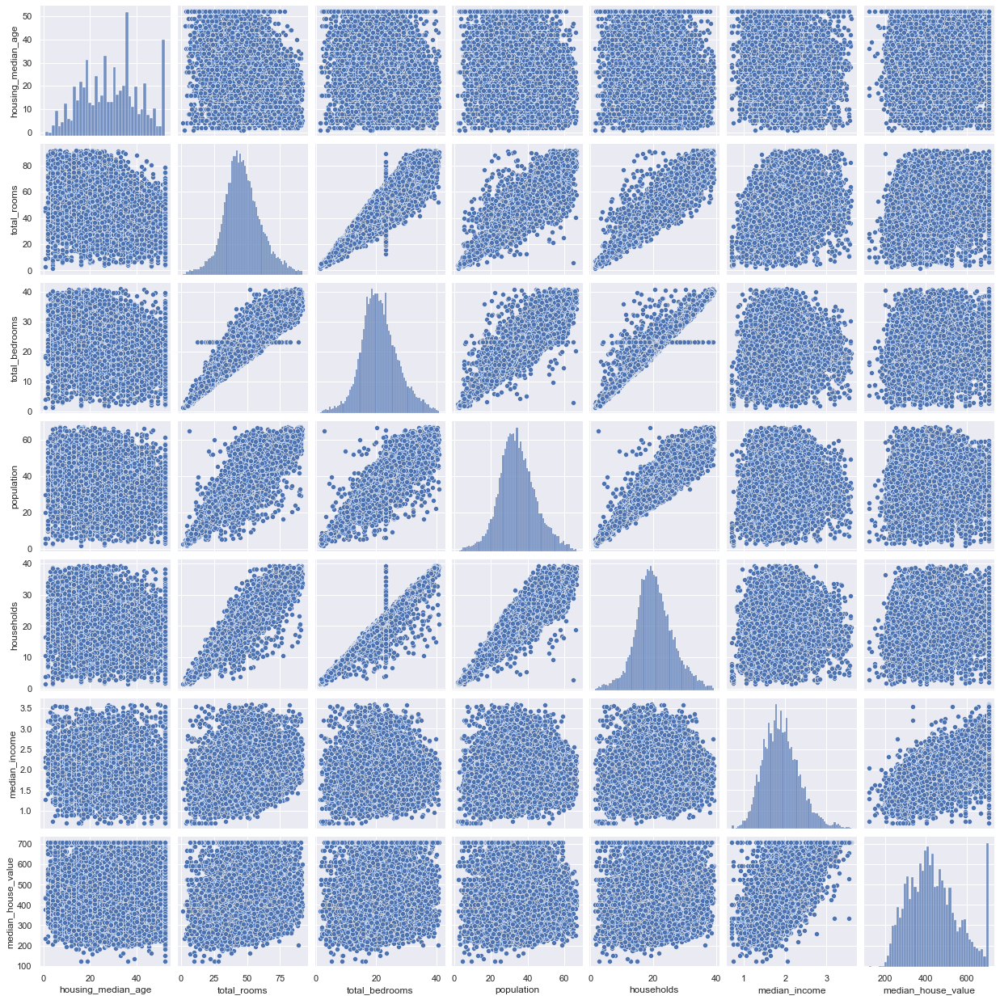

In [89]:
#scatterplot matrix
sns.set()
sns.pairplot(quant_vars, size = 2.5)
plt.show();

### Categorical Variables

These are variables that describe a 'characteristic' of a data unit and are selected from a small group of categories. In python, a categorical variable can have the type "Object" or "int64". A good way to visualize categorical variables is by using boxplots. Below is a boxplot that was generated to investigate the relationship between "ocean_proximity" and "median_house_value".

<AxesSubplot:xlabel='ocean_proximity', ylabel='median_house_value'>

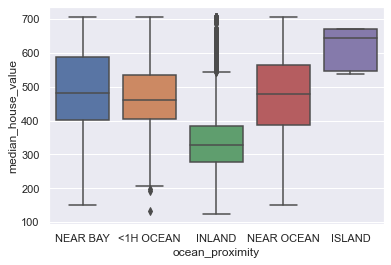

In [90]:
sns.boxplot(x="ocean_proximity", y="median_house_value", data=cal_new_df)

Here we see that the distribution of median house value between the five ocean proximity categories is distinct enough to take *ocean_proximity* as a potentially good predictor of *median_house_value*.

#### ANOVA: Analysis of Variance

<p>The Analysis of Variance (ANOVA) is a statistical method used to test whether there are significant differences between the means of two or more groups. ANOVA returns two parameters:</p>

<p><b>F-test score</b>: ANOVA assumes the means of all groups are the same, calculates how much the actual means deviate from the assumption and reports it as the F-test score. A larger score means there is a larger difference between the means.</p>

<p><b>P-value</b>:  P-value tells how statistically significant is our calculated score value.</p>

<p>If one variable is strongly correlated with the variable we are analyzing, expect ANOVA to return a sizeable F-test score and a small p-value.</p>


In [91]:
from scipy import stats

For this analysis, our conjecture is that the median_house_value differes significantly with the ocean_proximity. Thus, this aims at having sufficient evidence to reject the null hypothesis.

<ul>
    <li>$ H_0 $: median_house_value of houses with different ocean_proximities are equal</li>
    <li>$ H_1 $: median_house_value of houses with different ocean_proximities are not equal</li>
</ul>

We set $\alpha$ to be 0.05 which is referred to 95% confidence level.

In [93]:
# ANOVA 1
import statsmodels.api as sm
from statsmodels.formula.api import ols

model = ols('median_house_value ~ ocean_proximity',                 # Model formula
            data = cal_new_df).fit()
                
anova_result = sm.stats.anova_lm(model, typ=2)
print (anova_result)

                       sum_sq       df            F  PR(>F)
ocean_proximity  8.528179e+07      4.0  2008.970587     0.0
Residual         2.107985e+08  19863.0          NaN     NaN


This is a great result, with a large F test score showing a strong correlation and a P-value of almost 0 implying almost certain statistical significance, thus we reject the null hypothesis. This implies that at the 95% confidence level, we reject the null hypothesis that the median_house_values of houses with different ocean proximities are equal.

Next, we could also check the extent of the relationship between the county and median house value. For this analysis, we conjecture that the median_house_value differs significantly from the county. Thus, this aims at having sufficient evidence to reject the null hypothesis.

<ul>
    <li>$ H_0 $: median_house_value of houses with different counties are equal</li>
    <li>$ H_1 $: median_house_value of houses with different counties are not equal</li>
</ul>

We set $\alpha$ to be 0.05 which is referred to 95% confidence level.

In [97]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

model = ols('median_house_value ~ county',                 # Model formula
            data = cal_new_df).fit()
                
anova_result = sm.stats.anova_lm(model, typ=2)
print (anova_result)

                sum_sq       df           F  PR(>F)
county    1.304209e+08     61.0  255.621722     0.0
Residual  1.656595e+08  19806.0         NaN     NaN


This is a great result, with a large F test score showing a strong correlation and a P-value of almost 0 implying almost certain statistical significance, thus we reject the null hypothesis. This implies that at the 95% confidence level, we reject the null hypothesis that the median_house_values of houses with different ocean proximities are equal.

In [98]:
cal_new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19868 entries, 0 to 19867
Data columns (total 13 columns):
 #   Column              Non-Null Count  Dtype   
---  ------              --------------  -----   
 0   id                  19868 non-null  int64   
 1   longitude           19868 non-null  float64 
 2   latitude            19868 non-null  float64 
 3   housing_median_age  19868 non-null  float64 
 4   total_rooms         19868 non-null  float64 
 5   total_bedrooms      19868 non-null  float64 
 6   population          19868 non-null  float64 
 7   households          19868 non-null  float64 
 8   median_income       19868 non-null  float64 
 9   median_house_value  19868 non-null  float64 
 10  ocean_proximity     19868 non-null  object  
 11  median-age-bins     19868 non-null  category
 12  county              19868 non-null  object  
dtypes: category(1), float64(9), int64(1), object(2)
memory usage: 1.8+ MB


In [99]:
# drop county
cal_new_df.drop('county', inplace=True, axis=1)

In [100]:
# drop median-age-bins
cal_new_df.drop('median-age-bins', inplace=True, axis=1)

In [101]:
cal_new_df.head()

,id,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,1,-122.23,37.88,41.0,29.664794,11.357817,17.944358,11.224972,2.885342,672.755528,NEAR BAY
1,2,-122.22,37.86,21.0,84.255564,33.256578,49.000000,33.734256,2.881215,598.748695,NEAR BAY
2,3,-122.24,37.85,52.0,38.301436,13.784049,22.271057,13.304135,2.693956,593.380148,NEAR BAY
3,4,-122.25,37.85,52.0,35.693137,15.329710,23.622024,14.798649,2.375521,584.208867,NEAR BAY
4,5,-122.25,37.85,52.0,40.336088,16.733201,23.769729,16.093477,1.961173,584.978632,NEAR BAY


### Feature Engineering

#### Feature encoding

Most of the machine learning algorithms work on numerical data only and will not be able to process Categorical data. So we need to transform categorical data into numerical form without losing the sense of information. Since the ocean_proximity variable has no ranking properties, I used the one-hot encoding function of python.

In [102]:
# one hot encoding
cal_onehot = pd.get_dummies(cal_new_df['ocean_proximity'], prefix="", prefix_sep="")

# merge with main df bridge_df on key values
cal_new_df = cal_new_df.join(cal_onehot)
cal_new_df.head()

,id,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN
0,1,-122.23,37.88,41.0,29.664794,11.357817,17.944358,11.224972,2.885342,672.755528,NEAR BAY,0,0,0,1,0
1,2,-122.22,37.86,21.0,84.255564,33.256578,49.000000,33.734256,2.881215,598.748695,NEAR BAY,0,0,0,1,0
2,3,-122.24,37.85,52.0,38.301436,13.784049,22.271057,13.304135,2.693956,593.380148,NEAR BAY,0,0,0,1,0
3,4,-122.25,37.85,52.0,35.693137,15.329710,23.622024,14.798649,2.375521,584.208867,NEAR BAY,0,0,0,1,0
4,5,-122.25,37.85,52.0,40.336088,16.733201,23.769729,16.093477,1.961173,584.978632,NEAR BAY,0,0,0,1,0


#### Feature Scaling

Feature scaling is one of the most important prerequisites for most machine learning algorithm. Various features of the dataset can have their range of values and far different from each other. For instance, attributes such as median_house_value tend to be really large numbers compared to, say, the number of bedrooms and when used without scaling, it tends to dominate the scores beyond its allotted weight.

To rectify this, all numerical columns were scaled to a uniform range of 0-1 using the *MinMaxScaler* function from the **scikit-learn** library. 

In [103]:
from sklearn.preprocessing import MinMaxScaler
minmax_scaler = MinMaxScaler()
cal_new_df[['housing_median_age', 'total_rooms',
            'total_bedrooms', 'population', 
            'households', 'median_income',
            'median_house_value']] = minmax_scaler.fit_transform(cal_new_df[['housing_median_age', 'total_rooms', 
                                                                             'total_bedrooms', 'population', 
                                                                             'households', 'median_income',
                                                                             'median_house_value']])
cal_new_df.head()

,id,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity,<1H OCEAN,INLAND,ISLAND,NEAR BAY,NEAR OCEAN
0,1,-122.23,37.88,0.784314,0.312767,0.251424,0.249224,0.258565,0.752999,0.941242,NEAR BAY,0,0,0,1,0
1,2,-122.22,37.86,0.392157,0.917152,0.805133,0.726627,0.851802,0.751573,0.814656,NEAR BAY,0,0,0,1,0
2,3,-122.24,37.85,1.000000,0.408385,0.312771,0.315736,0.313362,0.686841,0.805474,NEAR BAY,0,0,0,1,0
3,4,-122.25,37.85,1.000000,0.379508,0.351853,0.336504,0.352750,0.576764,0.789786,NEAR BAY,0,0,0,1,0
4,5,-122.25,37.85,1.000000,0.430911,0.387340,0.338774,0.386875,0.433532,0.791103,NEAR BAY,0,0,0,1,0


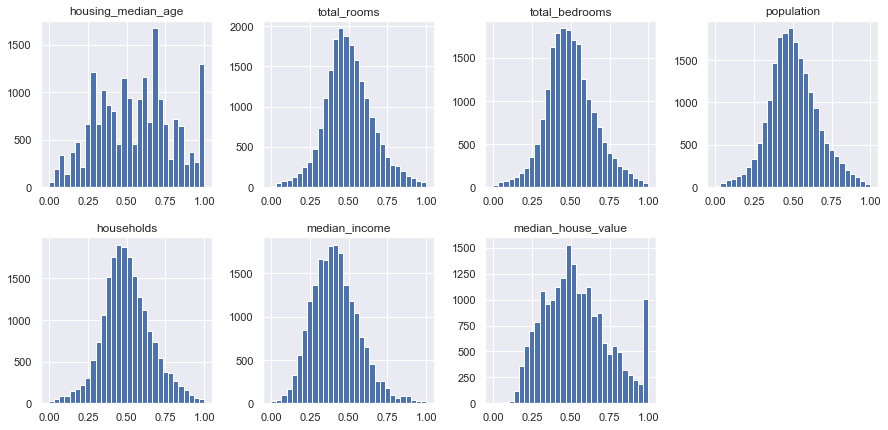

In [104]:
# explore distribution of numeric columns
ax_list = cal_new_df[num_cols].hist(bins=30, layout=(4,4), figsize=(15,15))

# Conclusion

This article demonstrates how data science and machine learning can be employed in one aspect of the real estate industry. As shown in this study, Python libraries such as Pandas can be used for visualization and statistical analysis, and libraries such as Folium and the ArcGIS API for Python for spatial analysis.

I sort to make a simple illustration of some of the most common and important steps involved in data preprocessing. Usually, the depth to which one will go in exploring the data will depend on what kind of relationships you seek to uncover. In most cases the process may not be as simple as I have shown it here, starting from the data retrieval stage, data is generally not easily accessible. Secondly, the data cleaning stage will most likely be an iterative process as you may have to run different tests over and over just to ensure that the data is clean enough for the model.

Another thing to note is that the input data was spatially enriched with information about the different counties where observed districts are found. This could be extended to further engineering using various APIs depending on the kind of model one intends to build and also the kind of business problem one seeks to answer.
